# GFE Classification: Part A

#####  This notebook aims to use Support Vector Machines (SVM) to classify facial capture footage as a specified emotion. Data exploration, training, and modelling will all be discussed below and mitigations will be provided. 
###### (i) Train/test SVM on GFE data on a single emotion and evaluate performance measures
###### (ii) Repeat test on a different facial expression


## Part 1: train negative emotion

In [337]:
import pandas as pd
import numpy as np
from sklearn import svm
from sklearn import preprocessing
from sklearn.model_selection import train_test_split,GridSearchCV,KFold, cross_val_score
from sklearn.metrics import accuracy_score, precision_score,plot_roc_curve, recall_score
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import pickle

In [338]:
# select emotion
emotion = "negative" 

# read in data file
df = pd.read_csv(f"grammatical_facial_expression/a_{emotion}_datapoints.txt",delimiter = " ",)
df_target = pd.read_csv(f"grammatical_facial_expression/a_{emotion}_targets.txt",delimiter = " ",)

In [339]:
# combine both dataframes using the target dataset
df['target'] = df_target

### Data Exploration

In [340]:
# summary statistics (exclude first/last columns)
df.iloc[:,1:-1].stack().describe()

count    337200.000000
mean        577.420882
std         471.213595
min           0.000000
25%         221.028750
50%         303.579000
75%        1225.000000
max        1585.000000
dtype: float64

Statistics indicate that the data has a range from 0 to 1585 with a standard deviation of 471, which suggests a large distribution of data. 

In [341]:
# search for NaN's, and remove if present
def find_nans(dataframe):
    is_NaN = dataframe.isnull()
    row_has_NaN = is_NaN.any(axis=1)
    return row_has_NaN

# remove NaN
df = df.drop(df[find_nans(df)].index)

In [179]:
# create violin plot to see the distribution of the data
px.violin(df.iloc[:,1:-1].unstack(), title="Violin Plot of Video Capture Data",
         labels={"variable": "Video Capture Data"})


The above violin plot indicates that there are 3 (2 large, 1 small) belts in the distribution of our data. This is most likely attributed to the three coordinate planes that our data is provided on (x,y, and z-axis) and would suggest that the scale of the data between the three planes are not similair. Further explore the data below.

In [100]:
# collect x,y, & z coordinates as separate dataframes
xs = df[df.columns[1::3]]
ys = df[df.columns[2::3]]
zs = df[df.columns[3::3]]

# remove target col
xs = xs.drop(['target'],axis=1)

# Look at 
fig = make_subplots(rows=1, cols=3,subplot_titles=("X-Axis Values Hist.","Y-Axis Values Hist.", "Z-Axis Values Hist."))
fig.add_trace(go.Histogram(x=xs.values.ravel(),name="x-axis"),
    row=1, col=1
)
fig.add_trace(go.Histogram(x=ys.values.ravel(),name="y-axis"),
    row=1, col=2
)
fig.add_trace(go.Histogram(x=zs.values.ravel(),name="z-axis"),
    row=1, col=3
)
fig.update_layout(title_text="Data Distribution Before Standardization")
fig.show()


The data distributions above indicate varying ranges between all three axes. Because of the varying scales, normalization would be an optimal preprocessing technique to apply to the data to ensure more accurate results.

This analysis will therefore test the modelling effects with and without scaling the data, with the former likely to produce superior results.

### Train/Test Split 


In [342]:
# split train/test and validation
X = df.iloc[:,1:-1]
y = df.iloc[:,-1]

In [343]:
# scale data
X_scaled = (X - X.min(axis=0)) / (X.max(axis=0)-X.min(axis=0))

### Support Vector Machine Classification

In order to optimize parameter estimates, 4-fold cross validation will be used to compare accuracies to optimize the kernel type, regularization parameter, and for the polynomial kernel the degree of the function.

In [133]:
# create empty model object
clf = svm.SVC()

# optimization paramters
kernel = ['linear','poly','rbf']
degree = [2,3,4,5,6,7,8,9,10]
C = [0.1,1,10, 50, 100, 200]
gamma = ["scale","auto"]
params = dict(kernel=kernel,degree=degree, C=C, gamma=gamma)

# Use GridSearch to optimize parameters through 5-Fold Cross Validation
grid = GridSearchCV(clf, params)
best = grid.fit(X,y)

In [134]:
print("Best Kernel:", best.best_estimator_.get_params()['kernel'])
print("Best Degree:", best.best_estimator_.get_params()['degree'])
print("Best C:", best.best_estimator_.get_params()['C'])
print("Best Gamma:", best.best_estimator_.get_params()['gamma'])

Best Kernel: poly
Best Degree: 7
Best C: 50
Best Gamma: scale


5-Fold Cross Validation indicates that:
Best Kernel: poly
Best Degree: 7
Best C: 50
Therefore reproduce model below with above inputs to generate best-fitting model.

In [86]:
# create SVM classifier object
clf = svm.SVC(C=50, kernel='poly',degree=7)

# specify the number of K-Folds
k = 5

# perform K-Fold cross validation and print the results
kfold = KFold(n_splits=k)
results = cross_val_score(clf, X, y)

print(results)
print("Accuracy: ", results.mean()*100)

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(("The least populated class in y has only %d"


[0.54666667 0.55111111 0.62222222 0.58666667 0.57142857]
Accuracy:  57.561904761904756


The SVC model produces a 5-KFold Cross Validation adjusted accuracy of 84.69% after optimization of the parameters.

### SVM Classification Optimization using K-Fold

In [316]:
# create empty model object
clf_scaled = svm.SVC()

# optimization paramters
kernel = ['linear','poly','rbf']
degree = [2,3,4,5,6,7,8,9,10]
C = [0.1, 1, 10, 50, 100, 200]
gamma = ["auto","scale"]
params = dict(kernel=kernel,degree=degree,C=C,gamma=gamma)

# Use GridSearch to optimize parameters through 5-Fold Cross Validation
grid = GridSearchCV(clf_scaled, params)
best = grid.fit(X_scaled,y)

KeyboardInterrupt: 

In [144]:
print("Best Kernel:", best.best_estimator_.get_params()['kernel'])
print("Best Degree:", best.best_estimator_.get_params()['degree'])
print("Best C:", best.best_estimator_.get_params()['C'])
print("Best Gamma:", best.best_estimator_.get_params()['gamma'])

Best Kernel: poly
Best Degree: 3
Best C: 200
Best Gamma: scale


5-Fold Cross Validation indicates that:
Best Kernel: poly
Best Degree: 3
Best C: 1
Best Gamma: scale
Therefore reproduce model below with above inputs to generate best-fitting model.

In [317]:
# create SVM classifier object
clf_scaled = svm.SVC(C=1, kernel='poly',degree=3,gamma="scale")

# specify the number of K-Folds
k = 5

# perform K-Fold cross validation and print the results
kfold = KFold(n_splits=k)
results = cross_val_score(clf_scaled, X_scaled, y)

print(results)
print("Accuracy: ", results.mean()*100)

[0.82666667 0.93333333 0.88888889 0.90625    0.87053571]
Accuracy:  88.51349206349207


The scaled SVC model produces accuracy of 88.51%, which is ~2% higher than using non-scaled data.

### Generate Final Model

Scaled data worked best on the User A model with an accuracy of 88.51%, therefore create a final model using scaled data. Split data 80/20 for training and testing, and calculate precision, accuracy, and ROC curve for model.


In [344]:
# split data 80/20
X_train_scaled, X_test_scaled, y_train, y_test = train_test_split(X_scaled, y, random_state=3,test_size=0.2)

# create model instance / pass optimizers defined above for "scaled data"
clf = svm.SVC(C=1, kernel='poly',degree=3,gamma="scale")

# fit model
clf.fit(X_train_scaled,y_train)

SVC(C=1, kernel='poly')

Model Accuracy: 0.9244444444444444
Model Precision: 0.9333333333333333
Model Recall: 0.9074074074074074


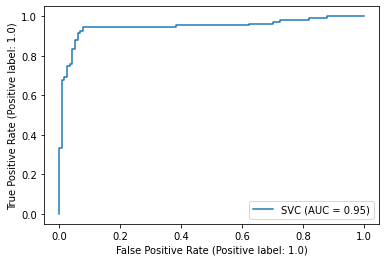

In [345]:
# make predictions on test data
y_pred = clf.predict(X_test_scaled)

# calculate model accuracy
acc = accuracy_score(y_test, y_pred)

# calculate model precision
prec = precision_score(y_test, y_pred)

# calculate model recall
recall = recall_score(y_test, y_pred)

print("Model Accuracy:", acc)
print("Model Precision:", prec)
print("Model Recall:", recall)

# plot ROC Curve
plot_roc_curve(clf,X_test_scaled,y_test)

The above results indicate that our final trained model has an accuracy of 92.4%, precision of 93.3%, and recall of 90.7% which indicates a very accurate model. AUC = 0.95 is excellent.

The ROC curve curves very close to 1 (top-left corner) and would suggest a model that has a very good tradeoff between sensitivity and specificity. This suggests the model has very good performance. 

## Part II: train affirmative emotion

In [336]:
# select emotion
emotion2 = "affirmative" 

# read in data file
df2 = pd.read_csv(f"grammatical_facial_expression/a_{emotion2}_datapoints.txt",delimiter = " ",)
df2_target = pd.read_csv(f"grammatical_facial_expression/a_{emotion2}_targets.txt",delimiter = " ",header=None)

In [326]:
# combine both dataframes using the target dataset
df2['target'] = df2_target

In [327]:
# summary statistics (exclude first/last columns)
df2.iloc[:,1:-1].stack().describe()

count    318600.000000
mean        568.698948
std         458.530090
min           0.000000
25%         227.417750
50%         299.007000
75%        1204.000000
max        1563.000000
dtype: float64

In [329]:
# search for NaN's, and remove if present
# remove NaN
df2 = df2.drop(df2[find_nans(df2)].index)

In [274]:
# create violin plot to see the distribution of the data
px.violin(df2.iloc[:,1:-1].unstack(), title="Violin Plot of Video Capture Data",
         labels={"variable": "Video Capture Data"})

The above graph/statistics confirms that the "affirmative" dataset has a very similar distribution to the "negative" dataset. 

Based on the success of using scaled data for the "negative" dataset, we will use only scaled data to build the model for the "affirmative" dataset.

### Train/Test Split 

In [330]:
# split train/test 70/30
X2 = df2.iloc[:,1:-1]
y2 = df2.iloc[:,-1]

# scale data
X2_scaled = (X2 - X2.min(axis=0)) / (X2.max(axis=0)-X2.min(axis=0))

### SVM Classification Optimization using K-Fold

In [331]:
# create empty model object
clf_scaled = svm.SVC()

# optimization paramters
kernel = ['linear','poly']
degree = [2,3,4,5,6,7,8,9,10]
C = [0.1, 1, 10, 50, 100, 200]
gamma = ["auto","scale"]
params = dict(kernel=kernel,degree=degree,C=C,gamma=gamma)

# Use GridSearch to optimize parameters through 5-Fold Cross Validation
grid = GridSearchCV(clf_scaled, params)
best = grid.fit(X2_scaled,y2)

KeyboardInterrupt: 

In [288]:
print("Best Kernel:", best.best_estimator_.get_params()['kernel'])
print("Best Degree:", best.best_estimator_.get_params()['degree'])
print("Best C:", best.best_estimator_.get_params()['C'])
print("Best Gamma:", best.best_estimator_.get_params()['gamma'])

Best Kernel: linear
Best Degree: 2
Best C: 10
Best Gamma: auto


In [289]:
# create SVM classifier object
clf_scaled = svm.SVC(C=10, kernel='linear',degree=5,gamma="auto")

# specify the number of K-Folds
k = 5

# perform K-Fold cross validation and print the results
kfold = KFold(n_splits=k)
results = cross_val_score(clf_scaled, X_scaled, y)

print(results)
print("Accuracy: ", results.mean()*100)

[0.79111111 0.92888889 0.90222222 0.91071429 0.85267857]
Accuracy:  87.7123015873016


Using 5 K-Fold Cross Validation, the parameters were optimized as the following:
Best Kernel: linear
Best Degree: 2
Best C: 10
Best Gamma: auto

And yielded an accuracy of 87.71%

### Generate Final Model

In [332]:
# split data 80/20
X2_train_scaled, X2_test_scaled, y2_train, y2_test = train_test_split(X2_scaled, y2, random_state=3,test_size=0.2)

# create model instance / pass optimizers defined above
clf2 = svm.SVC(C=10, kernel='linear',degree=5,gamma="auto")

# fit model
clf2.fit(X2_train_scaled,y2_train)

SVC(C=10, degree=5, gamma='auto', kernel='linear')

Model Accuracy: 0.8873239436619719
Model Precision: 0.8918918918918919
Model Recall: 0.8048780487804879


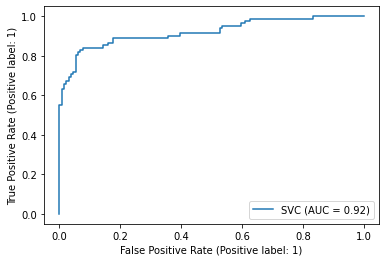

In [333]:
# make predictions on test data
y2_pred = clf2.predict(X2_test_scaled)

# calculate model accuracy
acc = accuracy_score(y2_test, y2_pred)

# calculate model precision
prec = precision_score(y2_test, y2_pred)

# calculate model recall
recall = recall_score(y2_test, y2_pred)

print("Model Accuracy:", acc)
print("Model Precision:", prec)
print("Model Recall:", recall)

# plot ROC Curve
plot_roc_curve(clf2,X2_test_scaled,y2_test)

The results of the trained model for the "affimative" dataset show 88.7% accuracy and a precision of 89.2%. A model recall value of 80.5% suggests the model chooses the positive sample over 80% of the time, which indicates a good classifier.

The ROC curve indicates a good balance between specificity and sensitivity. 

However, the "negative" model outperforms the "affimative" model.

### Save Models

In [346]:
# save the "negative" model to /models folder
filename = 'models/negative_svm.sav'
pickle.dump(clf, open(filename, 'wb'))

# save the "affirmative" model
filename = 'models/affirmative_svm.sav'
pickle.dump(clf2, open(filename, 'wb'))